In [ ]:
#Importing the necessary libraries
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn import model_selection
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.dummy import DummyClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix
from sklearn import svm
from sklearn.naive_bayes import GaussianNB
from collections import Counter
from sklearn.model_selection import cross_val_score
from sklearn.metrics import plot_confusion_matrix
import matplotlib.pyplot as plt
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import f1_score
from sklearn.metrics import auc
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve
from numpy import where
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
from scipy.stats import chi2_contingency
from scipy import stats as st
from sklearn import metrics
from IPython.display import display
from sklearn.preprocessing import PowerTransformer, QuantileTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from pprint import pprint
from sklearn.model_selection import RandomizedSearchCV
from sklearn.preprocessing import MinMaxScaler

IMPORTING THE DATASET

In [ ]:
#reading csv
df_donor_data = pd.read_csv("Final Donors List.csv")

In [ ]:
#shape of the dataset
df_donor_data.shape

(25367, 55)

In [ ]:
#info of the dataset
df_donor_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25367 entries, 0 to 25366
Data columns (total 55 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Unnamed: 0                  25367 non-null  int64  
 1   ID                          25367 non-null  int64  
 2   FIRST_NAME                  25367 non-null  object 
 3   MIDDLE_NAME                 24597 non-null  object 
 4   LAST_NAME                   25367 non-null  object 
 5   INFORMAL                    25367 non-null  object 
 6   ADDRESS_1                   25366 non-null  object 
 7   ADDRESS_2                   176 non-null    object 
 8   CITY                        25367 non-null  object 
 9   STATE_PROVINCE              25367 non-null  object 
 10  ZIP                         25367 non-null  object 
 11  COUNTRY                     25367 non-null  object 
 12  BIRTHDATE                   24497 non-null  object 
 13  ADDRESS UPDATED             214

In [ ]:
df_donor_data.head(5)

,Unnamed: 0,ID,FIRST_NAME,MIDDLE_NAME,LAST_NAME,INFORMAL,ADDRESS_1,ADDRESS_2,CITY,STATE_PROVINCE,...,BccAmount,BccReceived,BccBalance,BCC Donor,Chapter,BCC Chapter,BCC Chapter Status,Gift Officer Name_x,Gift Capacity Range (M&L),Target Tier
0,36,390603,Christian,L.,Berens,Christian,809 Evergreen Forest Dr,NaN,Saint Peters,MO,...,0.0,0.0,0.0,No,Theta Eta,No,No,Mrs. Barbara E. Barabas,$50K - $75K,Tier 2
1,40,391979,Kyle,P.,Peters,Kyle,7024 Rosabella Cir,NaN,Jacksonville,FL,...,50.0,50.0,0.0,Yes,Kappa Beta,Yes,BCC chapter before 2021,Mrs. Barbara E. Barabas,Unable to rate,Mass
2,118,386803,Cory,Robert,Smith,Cory,3910 Eagle Ridge Dr,NaN,Cape Girardeau,MO,...,0.0,0.0,0.0,No,Theta Eta,No,No,Mrs. Barbara E. Barabas,Unable to rate,Mass
3,126,386801,Leon,Eugene,Kirkpatrick,Lee,1135 S Delano Ct E,NaN,Chicago,IL,...,0.0,0.0,0.0,No,Theta Eta,No,No,Mrs. Barbara E. Barabas,$10K - $15K,Mass
4,134,388426,Erik,G.,Wagner,Erik,3001 E 18th 1/2 St,NaN,Austin,TX,...,0.0,0.0,0.0,No,Gamma Zeta,No,No,Mrs. Barbara E. Barabas,$25K - $30K,Tier 3


In [ ]:
#finding the unique values in the target variable
df_donor_data["RFM_Segment"].unique()

array(['Champions', 'Potential', "Can't Loose Them", 'Loyal', 'Promising',
       'One hit wonders', 'Needs Attention', 'Require Activation'],
      dtype=object)

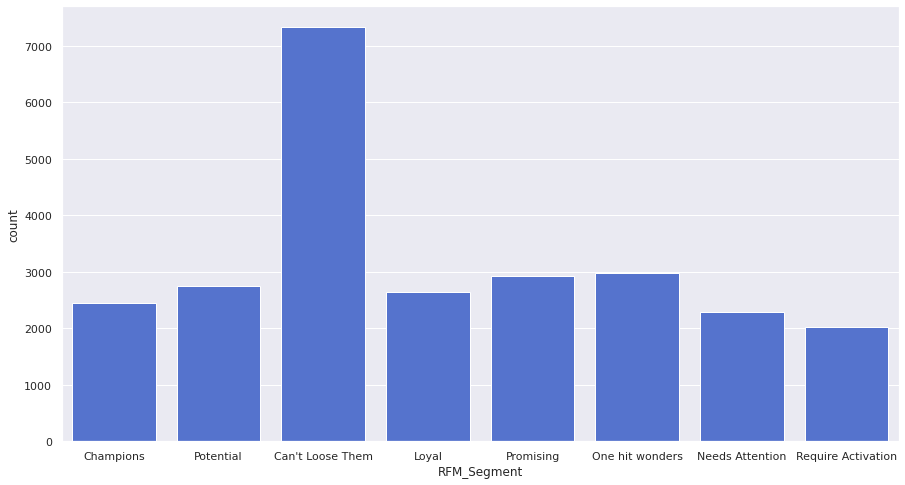

In [ ]:
#count plot of the target variable
sns.set(rc = {'figure.figsize':(15,8)})
sns.countplot(x='RFM_Segment', data=df_donor_data, palette= ['royalblue'])
plt.show()

HANDLING MISSING VALUES

In [ ]:
#missing values in the dataset
#the missing values in the datset are filled with a question mark

#replacing? with nan
df_donor_data = df_donor_data.replace('?', np.nan)

#counting the  missing values
df_donor_data.apply(lambda x: sum(x.isnull()),axis=0)

Unnamed: 0                        0
ID                                0
FIRST_NAME                        0
MIDDLE_NAME                     770
LAST_NAME                         0
INFORMAL                          0
ADDRESS_1                         1
ADDRESS_2                     25191
CITY                              0
STATE_PROVINCE                    0
ZIP                               0
COUNTRY                           0
BIRTHDATE                       870
ADDRESS UPDATED                3908
PLEDGE DATE                    1193
INITIATION DATE                 889
UNIV                              0
GRADUATION DATE                   0
WORK_PHONE                     9517
WORK PHONE UPDATED            10989
HOME_PHONE                     3969
HOME PHONE UPDATED             8040
CELL_PHONE                    16248
CELL PHONE UPDATED            18863
EMAIL                          4808
EMAIL UPDATED                  4541
DO_NOT_SOLICIT                    0
NO_FOUNDATION_MAIL          

In [ ]:
#Dropping features with high number of missing values and irrelevant to the analysis

df_donor_data = df_donor_data.drop(columns=['ID', 'FIRST_NAME', 'MIDDLE_NAME', 'LAST_NAME','INFORMAL', 'ADDRESS_2','ZIP', 'COUNTRY','BIRTHDATE', 'ADDRESS UPDATED','WORK_PHONE', 'WORK PHONE UPDATED','HOME_PHONE', 'HOME PHONE UPDATED', 'CELL_PHONE', 'CELL PHONE UPDATED', 'EMAIL', 'EMAIL UPDATED', 'Date of Birth' ])

In [ ]:
#deleting other columns which are not relevant
df_donor_data = df_donor_data.drop(columns=['ADDRESS_1', 'DO_NOT_SOLICIT', 'NO_FOUNDATION_MAIL', 'Bequest',
                                                               'Attribute 1_x', 'Status'])

DATA EXPLORATION

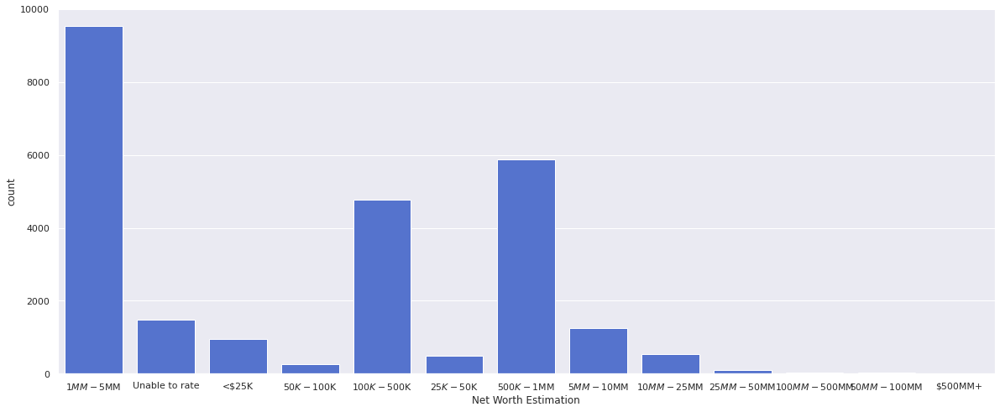

In [ ]:
sns.set(rc = {'figure.figsize':(20,8)})
sns.countplot(x='Net Worth Estimation', data=df_donor_data, palette= ['royalblue'])
plt.show()

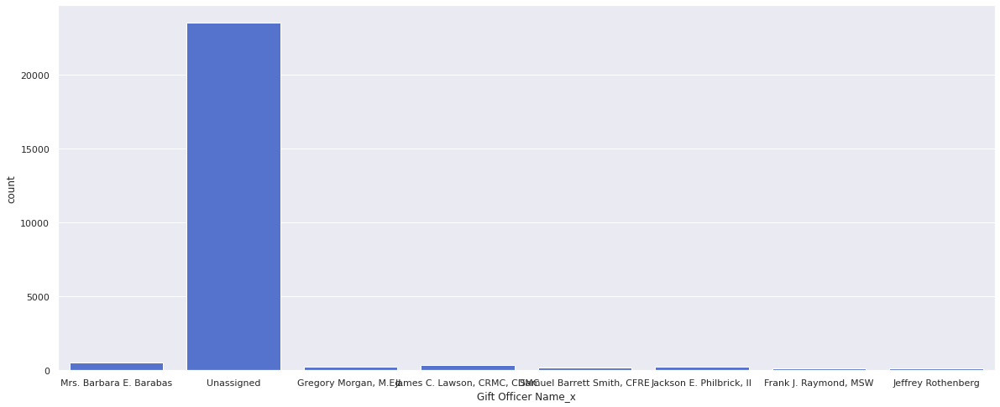

In [ ]:
sns.set(rc = {'figure.figsize':(20,8)})
sns.countplot(x='Gift Officer Name_x', data=df_donor_data, palette= ['royalblue'])
plt.show()

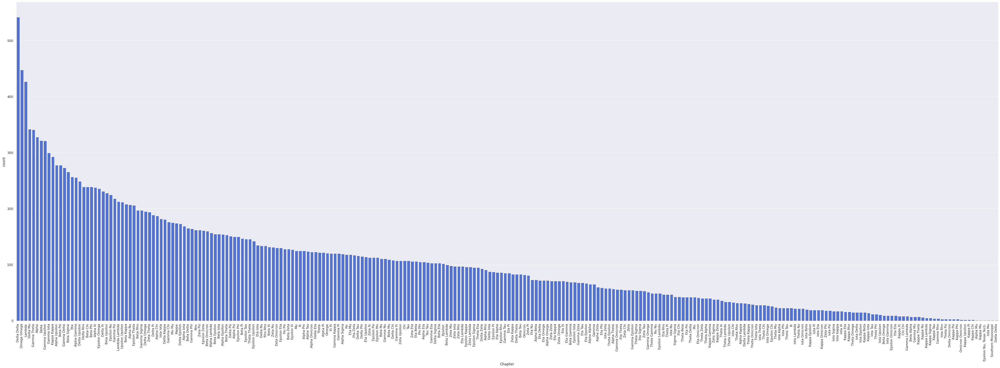

In [ ]:
sns.set(rc = {'figure.figsize':(60,20)})
sns.countplot(x='Chapter', data=df_donor_data, palette= ['royalblue'], order=df_donor_data['Chapter'].value_counts().index )
plt.xticks(rotation = 90, ) # Rotates X-Axis Ticks by 90-degrees
plt.show()

In [ ]:
df_donor_data['Chapter'].nunique()

254

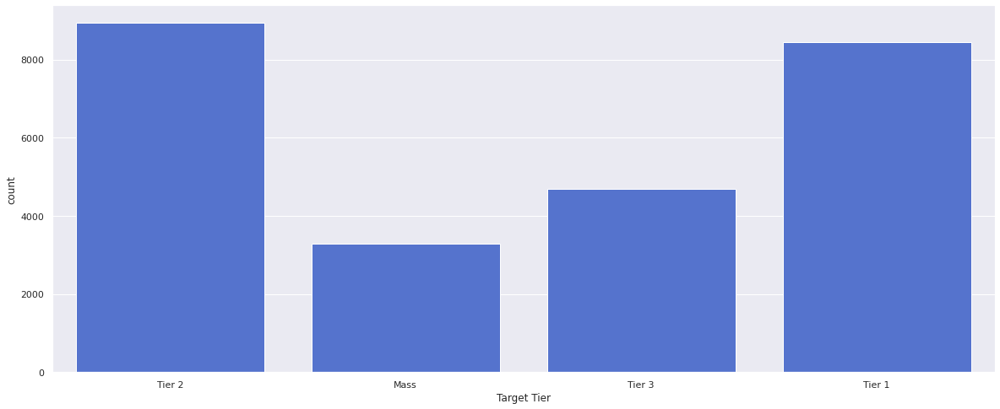

In [ ]:
sns.set(rc = {'figure.figsize':(20,8)})
sns.countplot(x='Target Tier', data=df_donor_data, palette= ['royalblue'])
plt.show()

CREATING CALUCULATED FIELDS

In [ ]:
df_donor_data['PLEDGE DATE'] = pd.to_datetime(df_donor_data['PLEDGE DATE'])

In [ ]:
df_donor_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25367 entries, 0 to 25366
Data columns (total 30 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   Unnamed: 0                  25367 non-null  int64         
 1   CITY                        25367 non-null  object        
 2   STATE_PROVINCE              25367 non-null  object        
 3   PLEDGE DATE                 24174 non-null  datetime64[ns]
 4   INITIATION DATE             24478 non-null  object        
 5   UNIV                        25367 non-null  object        
 6   GRADUATION DATE             25367 non-null  int64         
 7   Age Calculated field        25367 non-null  int64         
 8   Net Worth Estimation        25367 non-null  object        
 9   Inclination: Giving         25367 non-null  object        
 10  Income                      25367 non-null  object        
 11  Charitable Donations        25367 non-null  object    

In [ ]:
df_donor_data['Pledge_year'] = pd.DatetimeIndex(df_donor_data['PLEDGE DATE']).year

In [ ]:
from datetime import date
today = date.today()
df_donor_data["Pledge_years"]  = today.year - df_donor_data['Pledge_year']

In [ ]:
df_donor_data = df_donor_data.drop(columns=['PLEDGE DATE', 'BccAmount', 'BccReceived', 'BccBalance', 'BCC Chapter Status','Gift Officer Name_x'
                                                               , 'Pledge_year'])

In [ ]:
df_donor_data = df_donor_data.reindex(columns=['Unnamed: 0','CITY','STATE_PROVINCE','INITIATION DATE', 'UNIV', 'Chapter','GRADUATION DATE','Age Calculated field', 'Net Worth Estimation',
       'Inclination: Giving', 'Income', 'Charitable Donations', 'Total Donation Sum', 'Number of Years Donated','Average Donation Value',
                                                                'Percentile_Donation_Amount', 'DLV',
                                                               'Percentile_Donation_Freq','BCC Donor', 'BCC Chapter ', 'Gift Capacity Range (M&L)', 'Target Tier',
       'Pledge_years', 'RFM_Segment'])

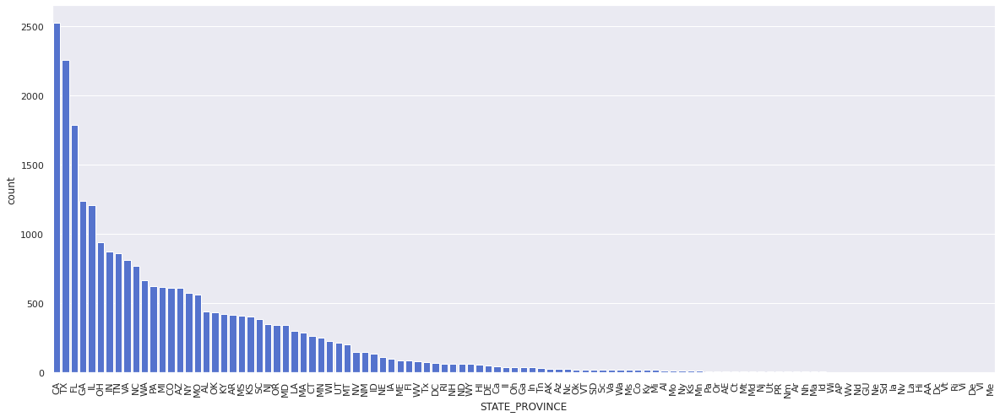

In [ ]:
sns.set(rc = {'figure.figsize':(20,8)})
sns.countplot(x='STATE_PROVINCE', data=df_donor_data, palette= ['royalblue'], order=df_donor_data['STATE_PROVINCE'].value_counts().index )
plt.xticks(rotation = 90, ) # Rotates X-Axis Ticks by 90-degrees)
plt.show()

In [ ]:
df_donor_data['STATE_PROVINCE'].unique()

array(['MO', 'FL', 'IL', 'TX', 'GA', 'MS', 'PA', 'Mn', 'NC', 'CA', 'Tx',
       'VA', 'MI', 'CO', 'NE', 'MA', 'TN', 'KY', 'OR', 'MT', 'AZ', 'IN',
       'UT', 'MN', 'RI', 'WA', 'OH', 'Wi', 'Fl', 'Il', 'AL', 'WY', 'CT',
       'KS', 'NY', 'NJ', 'WI', 'AR', 'MD', 'NM', 'OK', 'IA', 'Nc', 'WV',
       'ID', 'Oh', 'NH', 'DC', 'NV', 'LA', 'ME', 'SC', 'Co', 'Va', 'Ms',
       'ND', 'Wa', 'GU', 'Ky', 'Mi', 'Ga', 'HI', 'Ca', 'VT', 'Mo', 'Pa',
       'Tn', 'PR', 'Dc', 'Nv', 'In', 'Al', 'Sc', 'Ct', 'Ks', 'AE', 'Md',
       'Ok', 'AK', 'DE', 'SD', 'Or', 'Id', 'Ma', 'AP', 'Ut', 'Hi', 'Nj',
       'Ny', 'AA', 'Ar', 'Nd', 'Nh', 'Az', 'Ia', 'Mt', 'Sd', 'Ne', 'La',
       'Vi', 'Nm', 'De', 'VI', 'Vt', 'Me', 'Wv', 'Ri'], dtype=object)

In [ ]:
df_donor_data['STATE_PROVINCE'] = df_donor_data['STATE_PROVINCE'].str.upper()

In [ ]:
df_donor_data['STATE_PROVINCE'].unique()

array(['MO', 'FL', 'IL', 'TX', 'GA', 'MS', 'PA', 'MN', 'NC', 'CA', 'VA',
       'MI', 'CO', 'NE', 'MA', 'TN', 'KY', 'OR', 'MT', 'AZ', 'IN', 'UT',
       'RI', 'WA', 'OH', 'WI', 'AL', 'WY', 'CT', 'KS', 'NY', 'NJ', 'AR',
       'MD', 'NM', 'OK', 'IA', 'WV', 'ID', 'NH', 'DC', 'NV', 'LA', 'ME',
       'SC', 'ND', 'GU', 'HI', 'VT', 'PR', 'AE', 'AK', 'DE', 'SD', 'AP',
       'AA', 'VI'], dtype=object)

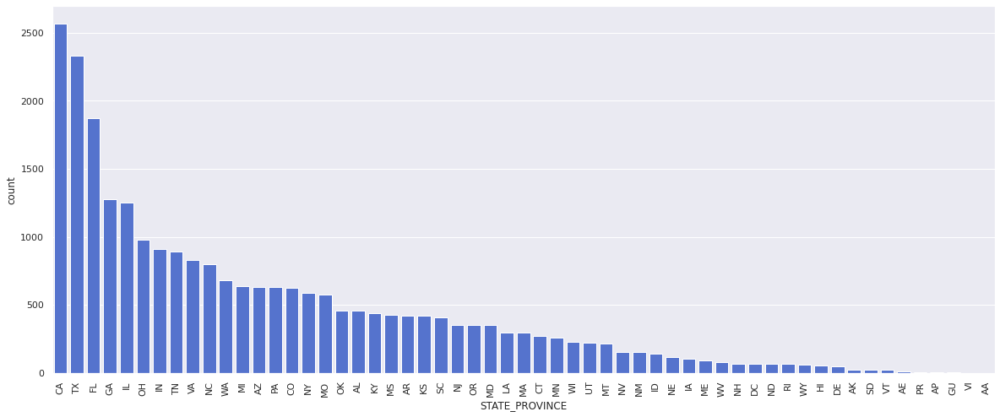

In [ ]:
sns.set(rc = {'figure.figsize':(20,8)})
sns.countplot(x='STATE_PROVINCE', data=df_donor_data, palette= ['royalblue'], order=df_donor_data['STATE_PROVINCE'].value_counts().index )
plt.xticks(rotation = 90, ) # Rotates X-Axis Ticks by 90-degrees))
plt.show()

In [ ]:
df_donor_data['CITY'] = df_donor_data['CITY'].str.upper()
print("number of uniques values in CITY variable", df_donor_data['CITY'].nunique())

number of uniques values in CITY variable 4331


CONVERTING THE CATEGORICAL VARIABLES

In [ ]:
df_donor_data['UNIV'], _ = pd.factorize(df_donor_data['UNIV'])

In [ ]:
df_donor_data['Chapter'], _ = pd.factorize(df_donor_data['Chapter'])
df_donor_data['STATE_PROVINCE'], _ = pd.factorize(df_donor_data['STATE_PROVINCE'])
df_donor_data['CITY'], _ = pd.factorize(df_donor_data['CITY'])

In [ ]:
df_donor_data['INITIATION DATE'] = pd.to_datetime(df_donor_data['INITIATION DATE'])

In [ ]:
df_donor_data['initiation_year'] = pd.DatetimeIndex(df_donor_data['INITIATION DATE']).year

In [ ]:
from datetime import date
today = date.today()
df_donor_data["initiation_years"]  = today.year - df_donor_data['initiation_year']

In [ ]:
df_donor_data = df_donor_data.drop(columns=['INITIATION DATE','initiation_year'])

NORMALIZING THE NUMERICAL VARIABLES

In [ ]:
from sklearn.preprocessing import PowerTransformer, QuantileTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from pprint import pprint
from sklearn.model_selection import RandomizedSearchCV
from sklearn.preprocessing import MinMaxScaler

num_cols = df_donor_data.columns[df_donor_data.dtypes.apply(lambda c: np.issubdtype(c, np.number))]

# used MinMaxScaler to Normalize the data
scaler = MinMaxScaler()
df_donor_data[num_cols] = scaler.fit_transform(df_donor_data[num_cols])

In [ ]:
list(df_donor_data.columns)

['Unnamed: 0',
 'CITY',
 'STATE_PROVINCE',
 'UNIV',
 'Chapter',
 'GRADUATION DATE',
 'Age Calculated field',
 'Net Worth Estimation',
 'Inclination: Giving',
 'Income',
 'Charitable Donations',
 'Total Donation Sum',
 'Number of Years Donated',
 'Average Donation Value',
 'Percentile_Donation_Amount',
 'DLV',
 'Percentile_Donation_Freq',
 'BCC Donor',
 'BCC Chapter ',
 'Gift Capacity Range (M&L)',
 'Target Tier',
 'Pledge_years',
 'RFM_Segment',
 'initiation_years']

In [ ]:
df_donor_data_corr = df_donor_data #dataframe for factorised data of categorical values
df_donor_data_onh = df_donor_data #dataframe for one hot encoded data of categorical values

In [ ]:
#factorising the categorical variables
df_donor_data_corr['Age Calculated field'], _ = pd.factorize(df_donor_data_corr['Age Calculated field'])
df_donor_data_corr['Inclination: Giving'], _ = pd.factorize(df_donor_data_corr['Inclination: Giving'])
df_donor_data_corr['Net Worth Estimation'], _ = pd.factorize(df_donor_data_corr['Net Worth Estimation'])
df_donor_data_corr['Income'], _ = pd.factorize(df_donor_data_corr['Income'])
df_donor_data_corr['Charitable Donations'], _ = pd.factorize(df_donor_data_corr['Charitable Donations'])
df_donor_data_corr['BCC Donor'], _ = pd.factorize(df_donor_data_corr['BCC Donor'])
df_donor_data_corr['BCC Chapter '], _ = pd.factorize(df_donor_data_corr['BCC Chapter '])
df_donor_data_corr['Gift Capacity Range (M&L)'], _ = pd.factorize(df_donor_data_corr['Gift Capacity Range (M&L)'])
df_donor_data_corr['Target Tier'], _ = pd.factorize(df_donor_data_corr['Target Tier'])

In [ ]:
df_donor_data_corr.head()

,Unnamed: 0,CITY,STATE_PROVINCE,UNIV,Chapter,GRADUATION DATE,Age Calculated field,Net Worth Estimation,Inclination: Giving,Income,...,Percentile_Donation_Amount,DLV,Percentile_Donation_Freq,BCC Donor,BCC Chapter,Gift Capacity Range (M&L),Target Tier,Pledge_years,RFM_Segment,initiation_years
0,0.001419,0.000000,0.000000,0.000,0.000000,1.000000,0,0,0,0,...,0.630651,0.001245,0.000000,0,0,0,0,0.666667,Champions,0.666667
1,0.001577,0.000231,0.017857,0.004,0.003953,1.000000,1,1,1,1,...,0.324400,0.000245,0.000000,1,1,1,1,0.666667,Potential,0.666667
2,0.004652,0.000462,0.000000,0.000,0.000000,1.000000,2,2,0,1,...,0.544089,0.000370,0.334897,0,0,1,1,0.676768,Can't Loose Them,0.666667
3,0.004967,0.000693,0.035714,0.000,0.000000,1.000000,2,3,0,2,...,0.591916,0.000495,0.334897,0,0,2,1,0.676768,Can't Loose Them,0.666667
4,0.005283,0.000924,0.053571,0.008,0.007905,0.983333,0,4,2,3,...,0.721894,0.000228,0.810827,0,0,3,2,0.676768,Can't Loose Them,0.676768


In [ ]:
df_donor_data_corr = df_donor_data_corr.drop(columns=['Unnamed: 0'])

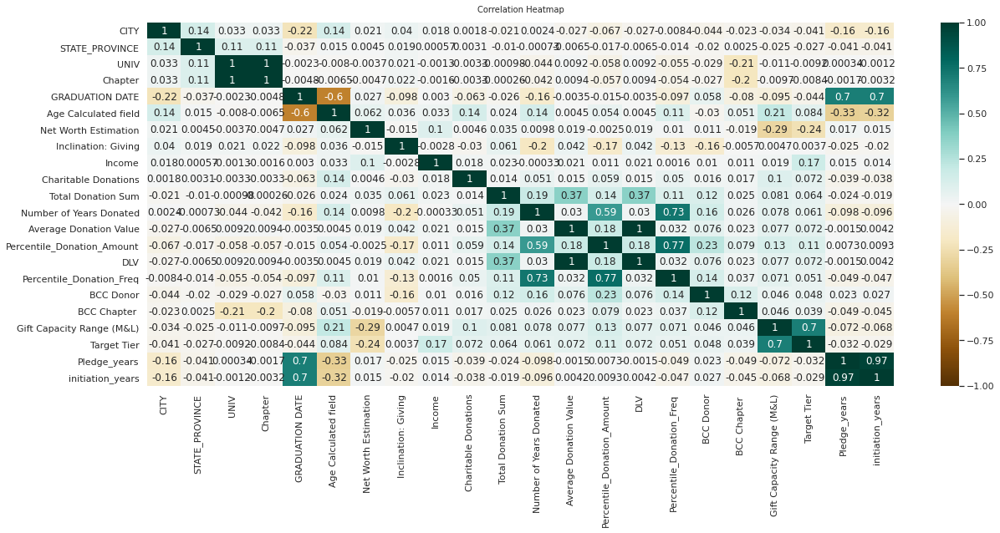

In [ ]:
#visualize the correlation of factorised variables
plt.figure(figsize=(20, 8))
heatmap = sns.heatmap(df_donor_data_corr.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':10}, pad=12);

In [ ]:
#dropping the variables which are highly correlated with a value of "1"
df_donor_data_corr = df_donor_data_corr.drop(columns=['UNIV','DLV','Pledge_years'])

In [ ]:
df_donor_data_corr.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25367 entries, 0 to 25366
Data columns (total 20 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   CITY                        25367 non-null  float64
 1   STATE_PROVINCE              25367 non-null  float64
 2   Chapter                     25367 non-null  float64
 3   GRADUATION DATE             25367 non-null  float64
 4   Age Calculated field        25367 non-null  int64  
 5   Net Worth Estimation        25367 non-null  int64  
 6   Inclination: Giving         25367 non-null  int64  
 7   Income                      25367 non-null  int64  
 8   Charitable Donations        25367 non-null  int64  
 9   Total Donation Sum          25367 non-null  float64
 10  Number of Years Donated     25367 non-null  float64
 11  Average Donation Value      25367 non-null  float64
 12  Percentile_Donation_Amount  25367 non-null  float64
 13  Percentile_Donation_Freq    253

In [ ]:
df_donor_data_corr['RFM_Segment'].unique()

array(['Champions', 'Potential', "Can't Loose Them", 'Loyal', 'Promising',
       'One hit wonders', 'Needs Attention', 'Require Activation'],
      dtype=object)

In [ ]:
df_donor_data_corr['RFM_Segment'] = df_donor_data_corr['RFM_Segment'].map({"Can't Loose Them": 7, 'Champions': 6, "Loyal": 5, "Promising": 4, "Potential": 3, "Needs Attention": 2, "Require Activation": 1, "One hit wonders": 0})

In [ ]:
df_donor_data_corr.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25367 entries, 0 to 25366
Data columns (total 20 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   CITY                        25367 non-null  float64
 1   STATE_PROVINCE              25367 non-null  float64
 2   Chapter                     25367 non-null  float64
 3   GRADUATION DATE             25367 non-null  float64
 4   Age Calculated field        25367 non-null  int64  
 5   Net Worth Estimation        25367 non-null  int64  
 6   Inclination: Giving         25367 non-null  int64  
 7   Income                      25367 non-null  int64  
 8   Charitable Donations        25367 non-null  int64  
 9   Total Donation Sum          25367 non-null  float64
 10  Number of Years Donated     25367 non-null  float64
 11  Average Donation Value      25367 non-null  float64
 12  Percentile_Donation_Amount  25367 non-null  float64
 13  Percentile_Donation_Freq    253

In [ ]:
df_donor_data_corr.head()

,CITY,STATE_PROVINCE,Chapter,GRADUATION DATE,Age Calculated field,Net Worth Estimation,Inclination: Giving,Income,Charitable Donations,Total Donation Sum,Number of Years Donated,Average Donation Value,Percentile_Donation_Amount,Percentile_Donation_Freq,BCC Donor,BCC Chapter,Gift Capacity Range (M&L),Target Tier,RFM_Segment,initiation_years
0,0.000000,0.000000,0.000000,1.000000,0,0,0,0,0,0.000102,0.000000,0.001245,0.630651,0.000000,0,0,0,0,6,0.666667
1,0.000231,0.017857,0.003953,1.000000,1,1,1,1,1,0.000020,0.000000,0.000245,0.324400,0.000000,1,1,1,1,3,0.666667
2,0.000462,0.000000,0.000000,1.000000,2,2,0,1,2,0.000061,0.020408,0.000370,0.544089,0.334897,0,0,1,1,7,0.666667
3,0.000693,0.035714,0.000000,1.000000,2,3,0,2,3,0.000082,0.020408,0.000495,0.591916,0.334897,0,0,2,1,7,0.666667
4,0.000924,0.053571,0.007905,0.983333,0,4,2,3,1,0.000191,0.081633,0.000228,0.721894,0.810827,0,0,3,2,7,0.676768


In [ ]:
df_donor_data_corr['RFM_Segment'].unique()

array([6, 3, 7, 5, 4, 0, 2, 1])

In [ ]:
df_donor_data_corr.fillna(0)

,CITY,STATE_PROVINCE,Chapter,GRADUATION DATE,Age Calculated field,Net Worth Estimation,Inclination: Giving,Income,Charitable Donations,Total Donation Sum,Number of Years Donated,Average Donation Value,Percentile_Donation_Amount,Percentile_Donation_Freq,BCC Donor,BCC Chapter,Gift Capacity Range (M&L),Target Tier,RFM_Segment,initiation_years
0,0.000000,0.000000,0.000000,1.000000,0,0,0,0,0,0.000102,0.000000,0.001245,0.630651,0.000000,0,0,0,0,6,0.666667
1,0.000231,0.017857,0.003953,1.000000,1,1,1,1,1,0.000020,0.000000,0.000245,0.324400,0.000000,1,1,1,1,3,0.666667
2,0.000462,0.000000,0.000000,1.000000,2,2,0,1,2,0.000061,0.020408,0.000370,0.544089,0.334897,0,0,1,1,7,0.666667
3,0.000693,0.035714,0.000000,1.000000,2,3,0,2,3,0.000082,0.020408,0.000495,0.591916,0.334897,0,0,2,1,7,0.666667
4,0.000924,0.053571,0.007905,0.983333,0,4,2,3,1,0.000191,0.081633,0.000228,0.721894,0.810827,0,0,3,2,7,0.676768
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25362,0.742956,0.339286,0.328063,0.266667,53,6,0,2,1,0.000020,0.020408,0.000120,0.324400,0.334897,0,1,0,0,5,0.000000
25363,0.999769,0.535714,0.158103,0.600000,34,4,5,2,1,0.000102,0.081633,0.000203,0.630651,0.694505,0,1,10,2,6,0.000000
25364,0.806467,0.142857,0.268775,0.366667,52,0,4,2,9,0.000041,0.000000,0.000495,0.457698,0.000000,0,1,13,3,4,0.030303
25365,1.000000,0.053571,0.454545,0.200000,30,2,6,1,1,0.000205,0.000000,0.002495,0.734187,0.000000,0,1,15,1,2,0.000000


In [ ]:
np.any(np.isnan(df_donor_data_corr))

True

In [ ]:
print(df_donor_data_corr.isnull().sum())

CITY                            0
STATE_PROVINCE                  0
Chapter                         0
GRADUATION DATE                 0
Age Calculated field            0
Net Worth Estimation            0
Inclination: Giving             0
Income                          0
Charitable Donations            0
Total Donation Sum              0
Number of Years Donated         0
Average Donation Value          0
Percentile_Donation_Amount      0
Percentile_Donation_Freq        0
BCC Donor                       0
BCC Chapter                     0
Gift Capacity Range (M&L)       0
Target Tier                     0
RFM_Segment                     0
initiation_years              889
dtype: int64


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='initiation_years'>

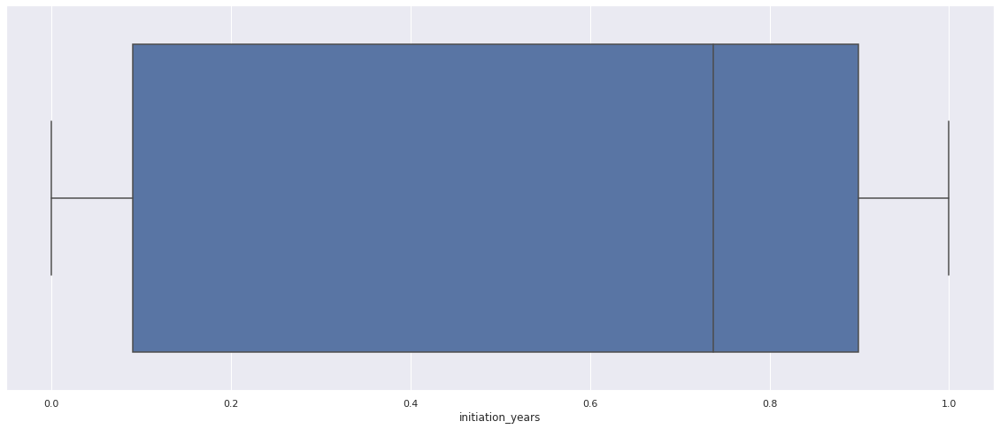

In [ ]:
sns.boxplot(df_donor_data_corr['initiation_years'])

In [ ]:
#assuming missing values in initiation years as '0' they have not pledged but donated
df_donor_data_corr['initiation_years'] = df_donor_data_corr['initiation_years'].fillna(0)

In [ ]:
print(df_donor_data_corr.isnull().sum())

CITY                          0
STATE_PROVINCE                0
Chapter                       0
GRADUATION DATE               0
Age Calculated field          0
Net Worth Estimation          0
Inclination: Giving           0
Income                        0
Charitable Donations          0
Total Donation Sum            0
Number of Years Donated       0
Average Donation Value        0
Percentile_Donation_Amount    0
Percentile_Donation_Freq      0
BCC Donor                     0
BCC Chapter                   0
Gift Capacity Range (M&L)     0
Target Tier                   0
RFM_Segment                   0
initiation_years              0
dtype: int64


TRAIN TEST SPLIT OF DATA

In [ ]:
#Startified train test Split-out dataset
from sklearn.model_selection import train_test_split

features = []
for feature in df_donor_data_corr.columns:
    if feature != 'RFM_Segment':
        features.append(feature)
X = df_donor_data_corr[features]
Y = df_donor_data_corr['RFM_Segment']

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, stratify=Y, test_size=0.25)


In [ ]:
Y_train.unique()

array([0, 7, 5, 2, 6, 1, 3, 4])

In [ ]:
Y_test.unique()

array([5, 7, 3, 6, 0, 1, 4, 2])

In [ ]:
np.any(np.isnan(X_train))

False

In [ ]:
np.all(np.isfinite(X_train))

True

In [ ]:
X_train.apply(lambda x: sum(x.isnull()),axis=0)

CITY                          0
STATE_PROVINCE                0
Chapter                       0
GRADUATION DATE               0
Age Calculated field          0
Net Worth Estimation          0
Inclination: Giving           0
Income                        0
Charitable Donations          0
Total Donation Sum            0
Number of Years Donated       0
Average Donation Value        0
Percentile_Donation_Amount    0
Percentile_Donation_Freq      0
BCC Donor                     0
BCC Chapter                   0
Gift Capacity Range (M&L)     0
Target Tier                   0
initiation_years              0
dtype: int64

RANDOM FOREST MODEL

Accuracy on the training data 0.987700394218134


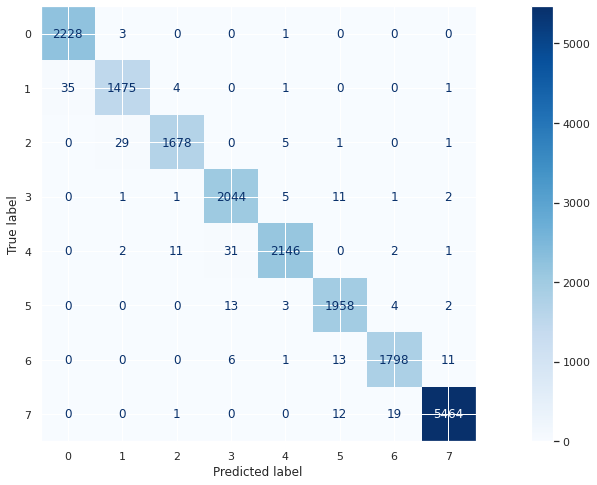

In [ ]:
#Fitting the Random Forest
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor

forest = RandomForestClassifier(n_estimators=10, random_state=42)
forest.fit(X_train, Y_train)

#the accuracy on the training data
print('Accuracy on the training data',forest.score(X_train,Y_train))

#confusion_matrix for the training
disp = plot_confusion_matrix(forest, X_train, Y_train ,display_labels=None, cmap=plt.cm.Blues)

Accuracy on the test data 0.7276884263639231
Precision: 0.727
Recall: 0.728
F1 Score: 0.726


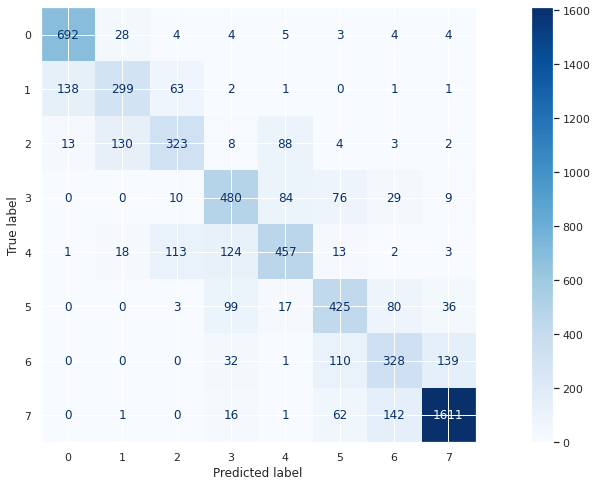

In [ ]:
# Testing the Random Forest Model

#the accuracy on the test data
print('Accuracy on the test data', forest.score(X_test, Y_test))

#Precision, Recall & F1-Score
Y_pred = forest.predict(X_test)
print('Precision: %.3f' % precision_score(Y_test, Y_pred, average='weighted'))
print('Recall: %.3f' % recall_score(Y_test, Y_pred, average='weighted'))
print('F1 Score: %.3f' % f1_score(Y_test, Y_pred, average='weighted'))

#confusion_matrix for the testing
disp = plot_confusion_matrix(forest, X_test, Y_test ,display_labels=None, cmap=plt.cm.Blues)

In [ ]:
# Define parameters
max_depth=[2, 4, 8, 12, 16, 20]
n_estimators = [64, 128, 256, 512]
param_grid = dict(max_depth=max_depth, n_estimators=n_estimators)

# Build the gridsearch
dfrst = RandomForestClassifier(n_estimators=n_estimators, max_depth=max_depth)
grid = GridSearchCV(estimator=dfrst, param_grid=param_grid, cv = 5)
grid_results = grid.fit(X_train, Y_train)

# Summarize the results in a readable format
print("Best: {0}, using {1}".format(grid_results.cv_results_['mean_test_score'], grid_results.best_params_))
results_df = pd.DataFrame(grid_results.cv_results_)
results_df

Best: [0.4857293  0.4878318  0.49072273 0.48898817 0.59237845 0.59695138
 0.59574244 0.5925887  0.72946124 0.73424442 0.73214192 0.7335611
 0.75547963 0.75689882 0.76010512 0.75716163 0.75563732 0.75842313
 0.759159   0.76063075 0.75206307 0.7587385  0.75858081 0.7587385 ], using {'max_depth': 16, 'n_estimators': 512}


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.351410,0.028212,0.022256,0.000099,2,64,"{'max_depth': 2, 'n_estimators': 64}",0.494875,0.494875,0.478055,0.483311,0.477530,0.485729,0.007737,24
1,0.662014,0.005370,0.042067,0.000156,2,128,"{'max_depth': 2, 'n_estimators': 128}",0.493824,0.492773,0.485940,0.484625,0.481997,0.487832,0.004652,23
2,1.333248,0.002280,0.081821,0.000452,2,256,"{'max_depth': 2, 'n_estimators': 256}",0.494612,0.497503,0.488830,0.485151,0.487516,0.490723,0.004605,21
3,2.722232,0.087494,0.164926,0.006587,2,512,"{'max_depth': 2, 'n_estimators': 512}",0.494087,0.491721,0.486465,0.485940,0.486728,0.488988,0.003293,22
4,0.503922,0.005268,0.027434,0.000118,4,64,"{'max_depth': 4, 'n_estimators': 64}",0.591853,0.587911,0.600526,0.598949,0.582654,0.592378,0.006698,20
5,0.972612,0.004185,0.052710,0.000146,4,128,"{'max_depth': 4, 'n_estimators': 128}",0.590539,0.604205,0.601577,0.603417,0.585020,0.596951,0.007737,17
6,1.941089,0.009779,0.103095,0.000276,4,256,"{'max_depth': 4, 'n_estimators': 256}",0.585020,0.592116,0.614192,0.591064,0.596321,0.595742,0.009907,18
7,3.869452,0.015211,0.203704,0.000770,4,512,"{'max_depth': 4, 'n_estimators': 512}",0.590013,0.586859,0.589750,0.602628,0.593693,0.592589,0.005469,19
8,0.811788,0.005610,0.037165,0.000110,8,64,"{'max_depth': 8, 'n_estimators': 64}",0.734823,0.722208,0.725361,0.732194,0.732720,0.729461,0.004822,16
9,1.568311,0.033177,0.072735,0.000794,8,128,"{'max_depth': 8, 'n_estimators': 128}",0.736925,0.732983,0.727201,0.739553,0.734560,0.734244,0.004163,13


Precision: 0.758
Recall: 0.759
F1 Score: 0.757


Text(0.5, 384.16, 'Predicted label')

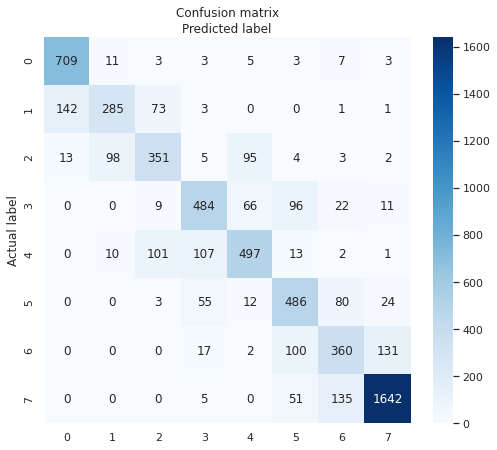

In [ ]:
# Extract the best decision forest
best_clf = grid_results.best_estimator_
Y_pred = best_clf.predict(X_test)

print('Precision: %.3f' % precision_score(Y_test, Y_pred, average='weighted'))
print('Recall: %.3f' % recall_score(Y_test, Y_pred, average='weighted'))
print('F1 Score: %.3f' % f1_score(Y_test, Y_pred, average='weighted'))

# Create a confusion matrix
cnf_matrix = confusion_matrix(Y_test, Y_pred)

# Create heatmap from the confusion matrix
class_names=[False, True] # name  of classes
fig, ax = plt.subplots(figsize=(7, 6))
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="Blues", fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix')
plt.ylabel('Actual label'); plt.xlabel('Predicted label')

In [ ]:
print(metrics.classification_report(Y_test, Y_pred, digits=8))

              precision    recall  f1-score   support

           0  0.82060185 0.95295699 0.88184080       744
           1  0.70544554 0.56435644 0.62706271       505
           2  0.65000000 0.61471103 0.63186319       571
           3  0.71281296 0.70348837 0.70811997       688
           4  0.73412112 0.67989056 0.70596591       731
           5  0.64541833 0.73636364 0.68789809       660
           6  0.59016393 0.59016393 0.59016393       610
           7  0.90468320 0.89579924 0.90021930      1833

    accuracy                      0.75906654      6342
   macro avg  0.72040587 0.71721627 0.71664174      6342
weighted avg  0.75831694 0.75906654 0.75700291      6342



AUC for Class 1: 0.9903392916825133
AUC for Class 2: 0.9676079703224734
AUC for Class 3: 0.9579065688973887
AUC for Class 4: 0.9594074682669606
AUC for Class 5: 0.9654467565542669
AUC for Class 6: 0.9571115057651489
AUC for Class 7: 0.9449112260190132
AUC for Class 8: 0.9870390757552605


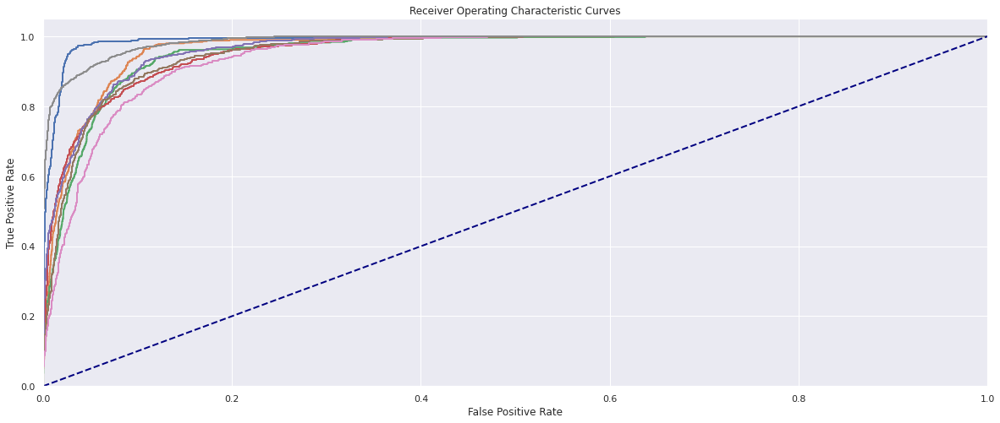

In [ ]:
from sklearn.preprocessing import label_binarize
best_clf = grid_results.best_estimator_
Y_score = best_clf.predict_proba(X_test)

#Binarize the output
y_test_bin = label_binarize(Y_test, classes=[0, 1, 2, 3, 4, 5, 6,7])
n_classes = y_test_bin.shape[1]

fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], Y_score[:, i])
    plt.plot(fpr[i], tpr[i], lw=2)
    print('AUC for Class {}: {}'.format(i+1, auc(fpr[i], tpr[i])))

plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic Curves')
plt.show()

NAIVE BAYES MODEL

Accuracy for the Naive Bayes Model on the training data 44.0420


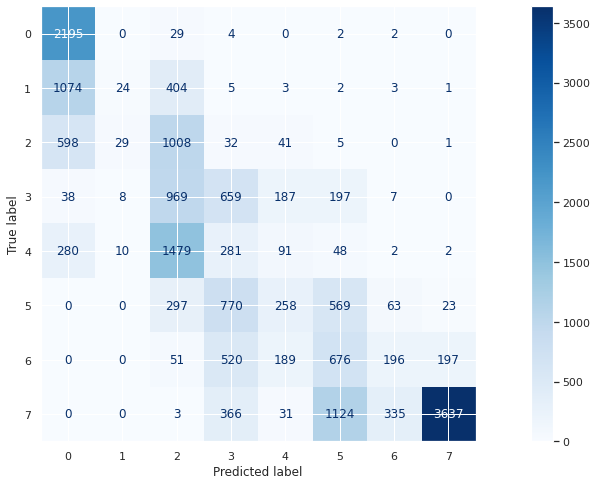

In [ ]:
#Fitting the Naive Bayes Model - Baseline

gnb = GaussianNB().fit(X_train, Y_train)

#accuracy on the training data
gnb_train_acc = gnb.score(X_train,Y_train)
print('Accuracy for the Naive Bayes Model on the training data %.4f' % (gnb_train_acc*100))

#confusion_matrix for the training
disp = plot_confusion_matrix(gnb, X_train, Y_train ,display_labels = None, cmap=plt.cm.Blues)

Accuracy for the Naive Bayes Model on the test data 42.7625
Precision: 0.4513
Recall: 0.4276
F1 Score: 0.4041


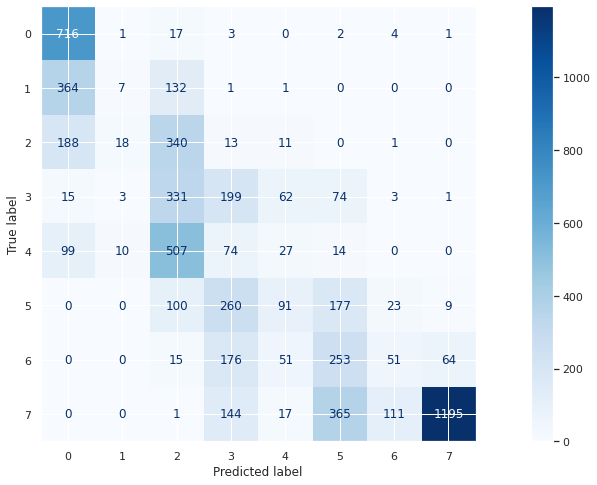

In [ ]:
#Testing the Naive Bayes Model- Baseline

#the accuracy on the test data
gnb_test_acc = gnb.score(X_test,Y_test)
print('Accuracy for the Naive Bayes Model on the test data %.4f' % (gnb_test_acc*100) )

#Precision, Recall & F1-Score
Y_naiveb = gnb.predict(X_test)
print('Precision: %.4f' % precision_score(Y_test, Y_naiveb, average='weighted'))
print('Recall: %.4f' % recall_score(Y_test, Y_naiveb, average='weighted'))
print('F1 Score: %.4f' % f1_score(Y_test, Y_naiveb, average='weighted'))

#confusion_matrix for the testing
disp = plot_confusion_matrix(gnb, X_test, Y_test ,display_labels=None, cmap=plt.cm.Blues)



Fitting 3 folds for each of 25 candidates, totalling 75 fits
[CV] var_smoothing=1.0 ...............................................
[CV] ................... var_smoothing=1.0, score=0.289, total=   0.0s
[CV] var_smoothing=1.0 ...............................................
[CV] ................... var_smoothing=1.0, score=0.289, total=   0.0s
[CV] var_smoothing=1.0 ...............................................
[CV] ................... var_smoothing=1.0, score=0.289, total=   0.0s
[CV] var_smoothing=0.4216965034285822 ................................
[CV] .... var_smoothing=0.4216965034285822, score=0.289, total=   0.0s
[CV] var_smoothing=0.4216965034285822 ................................
[CV] .... var_smoothing=0.4216965034285822, score=0.289, total=   0.0s
[CV] var_smoothing=0.4216965034285822 ................................
[CV] .... var_smoothing=0.4216965034285822, score=0.289, total=   0.0s
[CV] var_smoothing=0.1778279410038923 ................................
[CV] .... var_sm

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


[CV] ... var_smoothing=0.03162277660168379, score=0.291, total=   0.0s
[CV] var_smoothing=0.03162277660168379 ...............................
[CV] ... var_smoothing=0.03162277660168379, score=0.292, total=   0.0s
[CV] var_smoothing=0.03162277660168379 ...............................
[CV] ... var_smoothing=0.03162277660168379, score=0.293, total=   0.0s
[CV] var_smoothing=0.01333521432163324 ...............................
[CV] ... var_smoothing=0.01333521432163324, score=0.319, total=   0.0s
[CV] var_smoothing=0.01333521432163324 ...............................
[CV] ... var_smoothing=0.01333521432163324, score=0.320, total=   0.0s
[CV] var_smoothing=0.01333521432163324 ...............................
[CV] ... var_smoothing=0.01333521432163324, score=0.326, total=   0.0s
[CV] var_smoothing=0.005623413251903491 ..............................
[CV] .. var_smoothing=0.005623413251903491, score=0.371, total=   0.0s
[CV] var_smoothing=0.005623413251903491 ..............................
[CV] .

[Parallel(n_jobs=1)]: Done  75 out of  75 | elapsed:    1.2s finished


F1 Score: 0.5169
              precision    recall  f1-score   support

           0  0.55850234 0.96236559 0.70681145       744
           1  0.12877583 0.16039604 0.14285714       505
           2  0.47123288 0.30122592 0.36752137       571
           3  0.36622391 0.28052326 0.31769547       688
           4  0.38257576 0.27633379 0.32088959       731
           5  0.39351199 0.42272727 0.40759679       660
           6  0.35914333 0.35737705 0.35825801       610
           7  0.86843658 0.80305510 0.83446712      1833

    accuracy                      0.52554399      6342
   macro avg  0.44105033 0.44550050 0.43201212      6342
weighted avg  0.52852350 0.52554399 0.51689365      6342



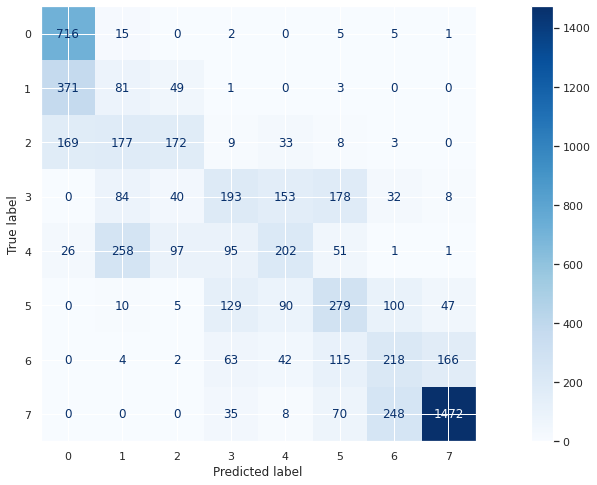

In [ ]:
#Hyperparameter Tuning the Naive Bayes Model

#Create the parameter grid
param_grid = {'var_smoothing': np.logspace(0,-9, num=25)}

gnb = GaussianNB()

# search of parameters, using 3 fold cross validation,
# search across 25 different combinations
gnb_random = GridSearchCV(gnb, param_grid, cv = 3, scoring = 'recall_weighted', refit = True, verbose = 3)

# Fit the random search model
gnb_random.fit(X_train, Y_train)

#print best parameters
print(gnb_random.best_params_)

#accuracy for best estimator
bestgnb = gnb_random.best_estimator_
best_gnb_acc = bestgnb.score(X_train,Y_train)
print('Accuracy of the Naive Bayes model data with hyperparameter tuning:  %.4f' % (best_gnb_acc*100))

#Precision, Recall & F1-Score
y_naivebhp = bestgnb.predict(X_test)
print('Precision: %.4f' % precision_score(Y_test, y_naivebhp, average='weighted'))
print('Recall: %.4f' % recall_score(Y_test, y_naivebhp, average='weighted'))
print('F1 Score: %.4f' % f1_score(Y_test, y_naivebhp, average='weighted'))

#confusion_matrix for the testing
disp = plot_confusion_matrix(bestgnb, X_test, Y_test ,display_labels=None, cmap=plt.cm.Blues)

print(metrics.classification_report(Y_test, y_naivebhp, digits=8))


K - MEANS CLUSTERING - UNSUPERVISED LEARNING

In [ ]:
df_donor_data_kmeans = df_donor_data_corr.drop(columns=['RFM_Segment'])

In [ ]:
# first we would like to know that how many cluster or to say donors can be clustered
# with less SSE(Sum of Squared Error) we will use "Elbow method" to find out

# KMeans instance
from sklearn.cluster import KMeans
km = KMeans()
k_rng = range(1,21)  # k value
sse = [] # sse value for each k
for i in k_rng:
    km = KMeans(n_clusters = i)
    km.fit(df_donor_data_kmeans)
    # calculating sse
    sse.append(km.inertia_)

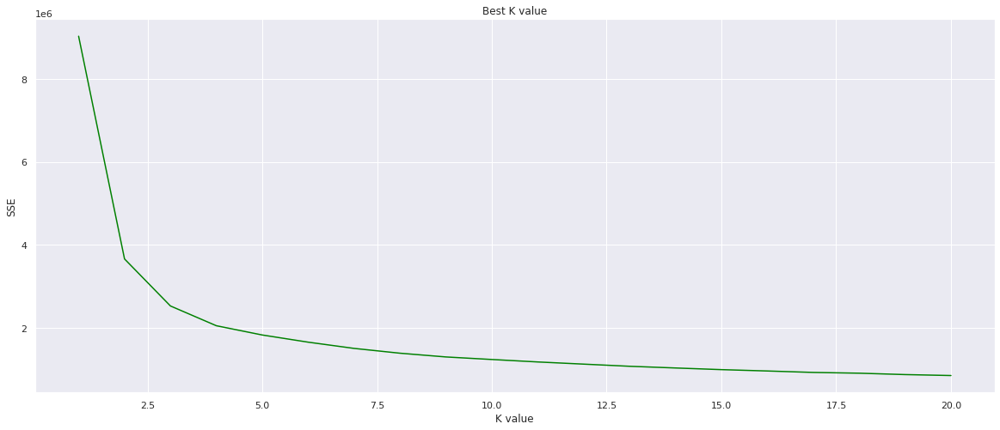

In [ ]:
plt.plot(k_rng, sse, color = 'green')
plt.xlabel('K value')
plt.ylabel('SSE')
plt.title('Best K value')
plt.show()

In [ ]:
df_donor_data_kmeans5 = df_donor_data_kmeans
df_donor_data_kmeans6 = df_donor_data_kmeans
df_donor_data_kmeans7 = df_donor_data_kmeans
df_donor_data_kmeans8 = df_donor_data_kmeans

In [ ]:
#with 5 clusters
kmeans5 = KMeans(n_clusters=5, init='k-means++', random_state=0).fit(df_donor_data_kmeans5)
df_donor_data_kmeans5['cluster5'] = kmeans5.predict(df_donor_data_kmeans5)

In [ ]:
from collections import Counter
Counter(kmeans5.labels_)

Counter({1: 3016, 4: 5542, 2: 5988, 3: 5951, 0: 4870})

In [ ]:
from sklearn.manifold import TSNE
donor_embedding5 = TSNE(n_components=2, verbose=2).fit_transform(df_donor_data_kmeans5)
projection5 = pd.DataFrame(columns=['x', 'y'], data=donor_embedding5)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 25367 samples in 0.091s...
[t-SNE] Computed neighbors for 25367 samples in 2.074s...
[t-SNE] Computed conditional probabilities for sample 1000 / 25367
[t-SNE] Computed conditional probabilities for sample 2000 / 25367
[t-SNE] Computed conditional probabilities for sample 3000 / 25367
[t-SNE] Computed conditional probabilities for sample 4000 / 25367
[t-SNE] Computed conditional probabilities for sample 5000 / 25367
[t-SNE] Computed conditional probabilities for sample 6000 / 25367
[t-SNE] Computed conditional probabilities for sample 7000 / 25367
[t-SNE] Computed conditional probabilities for sample 8000 / 25367
[t-SNE] Computed conditional probabilities for sample 9000 / 25367
[t-SNE] Computed conditional probabilities for sample 10000 / 25367
[t-SNE] Computed conditional probabilities for sample 11000 / 25367
[t-SNE] Computed conditional probabilities for sample 12000 / 25367
[t-SNE] Computed conditional probabilities for sam

In [ ]:
projection5['cluster5'] = df_donor_data_kmeans5['cluster5']

In [ ]:
projection5.head()

,x,y,cluster5
0,79.374802,-1.394897,1
1,79.688278,-4.413432,1
2,77.599297,-2.490667,1
3,72.905128,-3.731750,1
4,69.915749,-12.097898,1


In [ ]:
#with 6 clusters
kmeans6 = KMeans(n_clusters=6, init='k-means++', random_state=0).fit(df_donor_data_kmeans6)
df_donor_data_kmeans6['cluster6'] = kmeans6.predict(df_donor_data_kmeans6)

#TSNE -converting high dimensions into 2 dimensions
donor_embedding6 = TSNE(n_components=2, verbose=2).fit_transform(df_donor_data_kmeans6)
projection6 = pd.DataFrame(columns=['x', 'y'], data=donor_embedding6)

#adding cluster value to the reduced dimension dataframe
projection6['cluster6'] = df_donor_data_kmeans6['cluster6']

#plotting the cluster
fig6 = px.scatter(projection6, x='x', y='y', color='cluster6', hover_data=['x', 'y'])
fig6.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 25367 samples in 0.062s...
[t-SNE] Computed neighbors for 25367 samples in 2.159s...
[t-SNE] Computed conditional probabilities for sample 1000 / 25367
[t-SNE] Computed conditional probabilities for sample 2000 / 25367
[t-SNE] Computed conditional probabilities for sample 3000 / 25367
[t-SNE] Computed conditional probabilities for sample 4000 / 25367
[t-SNE] Computed conditional probabilities for sample 5000 / 25367
[t-SNE] Computed conditional probabilities for sample 6000 / 25367
[t-SNE] Computed conditional probabilities for sample 7000 / 25367
[t-SNE] Computed conditional probabilities for sample 8000 / 25367
[t-SNE] Computed conditional probabilities for sample 9000 / 25367
[t-SNE] Computed conditional probabilities for sample 10000 / 25367
[t-SNE] Computed conditional probabilities for sample 11000 / 25367
[t-SNE] Computed conditional probabilities for sample 12000 / 25367
[t-SNE] Computed conditional probabilities for sam

In [ ]:
#with 7 clusters
kmeans7 = KMeans(n_clusters=7, init='k-means++', random_state=0).fit(df_donor_data_kmeans7)
df_donor_data_kmeans7['cluster7'] = kmeans7.predict(df_donor_data_kmeans7)

#TSNE -converting high dimensions into 2 dimensions
donor_embedding7 = TSNE(n_components=2, verbose=2).fit_transform(df_donor_data_kmeans7)
projection7 = pd.DataFrame(columns=['x', 'y'], data=donor_embedding7)

#adding cluster value to the reduced dimension dataframe
projection7['cluster7'] = df_donor_data_kmeans7['cluster7']

#plotting the cluster
fig7 = px.scatter(projection7, x='x', y='y', color='cluster7', hover_data=['x', 'y'])
fig7.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 25367 samples in 0.062s...
[t-SNE] Computed neighbors for 25367 samples in 2.207s...
[t-SNE] Computed conditional probabilities for sample 1000 / 25367
[t-SNE] Computed conditional probabilities for sample 2000 / 25367
[t-SNE] Computed conditional probabilities for sample 3000 / 25367
[t-SNE] Computed conditional probabilities for sample 4000 / 25367
[t-SNE] Computed conditional probabilities for sample 5000 / 25367
[t-SNE] Computed conditional probabilities for sample 6000 / 25367
[t-SNE] Computed conditional probabilities for sample 7000 / 25367
[t-SNE] Computed conditional probabilities for sample 8000 / 25367
[t-SNE] Computed conditional probabilities for sample 9000 / 25367
[t-SNE] Computed conditional probabilities for sample 10000 / 25367
[t-SNE] Computed conditional probabilities for sample 11000 / 25367
[t-SNE] Computed conditional probabilities for sample 12000 / 25367
[t-SNE] Computed conditional probabilities for sam

In [ ]:
#with 8 clusters
kmeans8 = KMeans(n_clusters=8, init='k-means++', random_state=0).fit(df_donor_data_kmeans8)
df_donor_data_kmeans8['cluster8'] = kmeans8.predict(df_donor_data_kmeans8)

#TSNE -converting high dimensions into 2 dimensions
donor_embedding8 = TSNE(n_components=2, verbose=2).fit_transform(df_donor_data_kmeans8)
projection8 = pd.DataFrame(columns=['x', 'y'], data=donor_embedding8)

#adding cluster value to the reduced dimension dataframe
projection8['cluster8'] = df_donor_data_kmeans8['cluster8']

#plotting the cluster
fig8 = px.scatter(projection8, x='x', y='y', color='cluster8', hover_data=['x', 'y'])
fig8.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 25367 samples in 0.069s...
[t-SNE] Computed neighbors for 25367 samples in 2.338s...
[t-SNE] Computed conditional probabilities for sample 1000 / 25367
[t-SNE] Computed conditional probabilities for sample 2000 / 25367
[t-SNE] Computed conditional probabilities for sample 3000 / 25367
[t-SNE] Computed conditional probabilities for sample 4000 / 25367
[t-SNE] Computed conditional probabilities for sample 5000 / 25367
[t-SNE] Computed conditional probabilities for sample 6000 / 25367
[t-SNE] Computed conditional probabilities for sample 7000 / 25367
[t-SNE] Computed conditional probabilities for sample 8000 / 25367
[t-SNE] Computed conditional probabilities for sample 9000 / 25367
[t-SNE] Computed conditional probabilities for sample 10000 / 25367
[t-SNE] Computed conditional probabilities for sample 11000 / 25367
[t-SNE] Computed conditional probabilities for sample 12000 / 25367
[t-SNE] Computed conditional probabilities for sam

In [ ]:
df_donor_data_kmeans10 = df_donor_data_kmeans
#with 10 clusters
kmeans10 = KMeans(n_clusters=10, init='k-means++', random_state=0).fit(df_donor_data_kmeans10)
df_donor_data_kmeans10['cluster10'] = kmeans10.predict(df_donor_data_kmeans10)

#TSNE -converting high dimensions into 2 dimensions
donor_embedding10 = TSNE(n_components=2, verbose=2).fit_transform(df_donor_data_kmeans10)
projection10 = pd.DataFrame(columns=['x', 'y'], data=donor_embedding10)

#adding cluster value to the reduced dimension dataframe
projection10['cluster10'] = df_donor_data_kmeans10['cluster10']

#plotting the cluster
fig10 = px.scatter(projection10, x='x', y='y', color='cluster10', hover_data=['x', 'y'])
fig10.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 25367 samples in 0.067s...
[t-SNE] Computed neighbors for 25367 samples in 2.399s...
[t-SNE] Computed conditional probabilities for sample 1000 / 25367
[t-SNE] Computed conditional probabilities for sample 2000 / 25367
[t-SNE] Computed conditional probabilities for sample 3000 / 25367
[t-SNE] Computed conditional probabilities for sample 4000 / 25367
[t-SNE] Computed conditional probabilities for sample 5000 / 25367
[t-SNE] Computed conditional probabilities for sample 6000 / 25367
[t-SNE] Computed conditional probabilities for sample 7000 / 25367
[t-SNE] Computed conditional probabilities for sample 8000 / 25367
[t-SNE] Computed conditional probabilities for sample 9000 / 25367
[t-SNE] Computed conditional probabilities for sample 10000 / 25367
[t-SNE] Computed conditional probabilities for sample 11000 / 25367
[t-SNE] Computed conditional probabilities for sample 12000 / 25367
[t-SNE] Computed conditional probabilities for sam

In [ ]:
df_donor_data_kmeans12 = df_donor_data_kmeans
#with 12 clusters
kmeans12 = KMeans(n_clusters=12, init='k-means++', random_state=0).fit(df_donor_data_kmeans12)
df_donor_data_kmeans12['cluster12'] = kmeans12.predict(df_donor_data_kmeans12)

#TSNE -converting high dimensions into 2 dimensions
donor_embedding12 = TSNE(n_components=2, verbose=2).fit_transform(df_donor_data_kmeans12)
projection12 = pd.DataFrame(columns=['x', 'y'], data=donor_embedding12)

#adding cluster value to the reduced dimension dataframe
projection12['cluster12'] = df_donor_data_kmeans12['cluster12']

#plotting the cluster
fig12 = px.scatter(projection12, x='x', y='y', color='cluster12', hover_data=['x', 'y'])
fig12.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 25367 samples in 0.070s...
[t-SNE] Computed neighbors for 25367 samples in 2.439s...
[t-SNE] Computed conditional probabilities for sample 1000 / 25367
[t-SNE] Computed conditional probabilities for sample 2000 / 25367
[t-SNE] Computed conditional probabilities for sample 3000 / 25367
[t-SNE] Computed conditional probabilities for sample 4000 / 25367
[t-SNE] Computed conditional probabilities for sample 5000 / 25367
[t-SNE] Computed conditional probabilities for sample 6000 / 25367
[t-SNE] Computed conditional probabilities for sample 7000 / 25367
[t-SNE] Computed conditional probabilities for sample 8000 / 25367
[t-SNE] Computed conditional probabilities for sample 9000 / 25367
[t-SNE] Computed conditional probabilities for sample 10000 / 25367
[t-SNE] Computed conditional probabilities for sample 11000 / 25367
[t-SNE] Computed conditional probabilities for sample 12000 / 25367
[t-SNE] Computed conditional probabilities for sam

In [ ]:
df_donor_data_kmeans4 = df_donor_data_kmeans
#with 4 clusters
kmeans4 = KMeans(n_clusters=4, init='k-means++', random_state=0).fit(df_donor_data_kmeans4)
df_donor_data_kmeans4['cluster4'] = kmeans4.predict(df_donor_data_kmeans4)

#TSNE -converting high dimensions into 2 dimensions
donor_embedding4 = TSNE(n_components=2, verbose=2).fit_transform(df_donor_data_kmeans4)
projection4 = pd.DataFrame(columns=['x', 'y'], data=donor_embedding4)

#adding cluster value to the reduced dimension dataframe
projection4['cluster4'] = df_donor_data_kmeans4['cluster4']

#plotting the cluster
fig4 = px.scatter(projection4, x='x', y='y', color='cluster4', hover_data=['x', 'y'])
fig4.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 25367 samples in 0.071s...
[t-SNE] Computed neighbors for 25367 samples in 2.407s...
[t-SNE] Computed conditional probabilities for sample 1000 / 25367
[t-SNE] Computed conditional probabilities for sample 2000 / 25367
[t-SNE] Computed conditional probabilities for sample 3000 / 25367
[t-SNE] Computed conditional probabilities for sample 4000 / 25367
[t-SNE] Computed conditional probabilities for sample 5000 / 25367
[t-SNE] Computed conditional probabilities for sample 6000 / 25367
[t-SNE] Computed conditional probabilities for sample 7000 / 25367
[t-SNE] Computed conditional probabilities for sample 8000 / 25367
[t-SNE] Computed conditional probabilities for sample 9000 / 25367
[t-SNE] Computed conditional probabilities for sample 10000 / 25367
[t-SNE] Computed conditional probabilities for sample 11000 / 25367
[t-SNE] Computed conditional probabilities for sample 12000 / 25367
[t-SNE] Computed conditional probabilities for sam

K-NEAREST NEIGHBOR (KNN) MODEL

Accuracy for the KNeighborsClassifier on the training data 54.8804


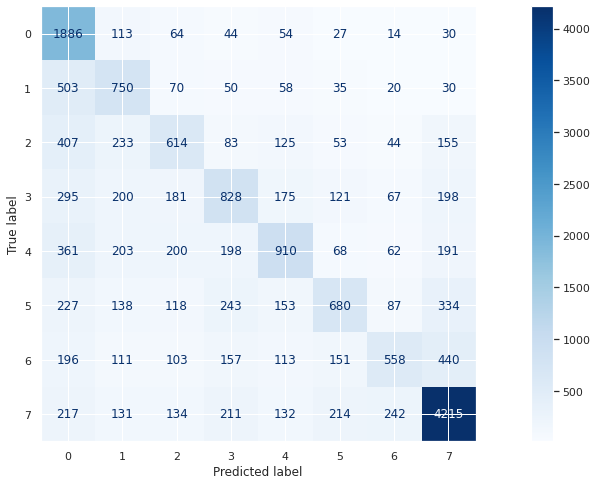

In [ ]:
#Fitting the KNN moel - Baseline

knn = KNeighborsClassifier().fit(X_train, Y_train)

#accuracy on the training data
knn_train_acc = knn.score(X_train,Y_train)
print('Accuracy for the KNeighborsClassifier on the training data %.4f'  % (knn_train_acc*100))

#confusion_matrix for the training
disp = plot_confusion_matrix(knn, X_train, Y_train ,display_labels=None, cmap=plt.cm.Blues)

Accuracy for the KNeighborsClassifier on the testing data 34.2006
Precision: 0.3209
Recall: 0.3420
F1 Score: 0.3241


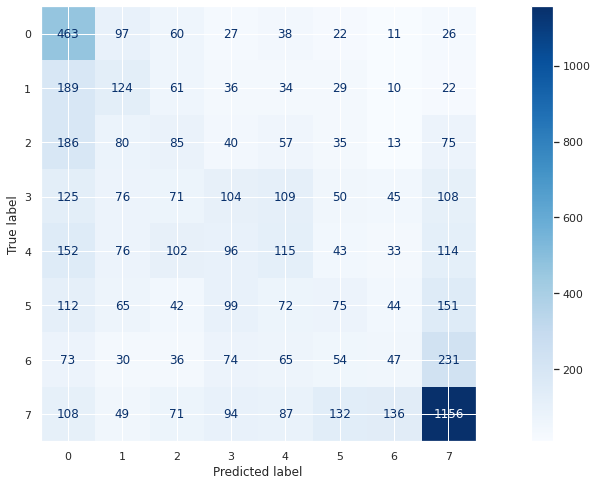

In [ ]:
# Testing the KNN Model- Baseline

#the accuracy on the test data
knn_test_acc = knn.score(X_test,Y_test)
print('Accuracy for the KNeighborsClassifier on the testing data %.4f'  % (knn_test_acc*100))

#Precision, Recall & F1-Score
Y_KNN = knn.predict(X_test)
print('Precision: %.4f' % precision_score(Y_test, Y_KNN, average='weighted'))
print('Recall: %.4f' % recall_score(Y_test, Y_KNN, average='weighted'))
print('F1 Score: %.4f' % f1_score(Y_test, Y_KNN, average='weighted'))

#confusion_matrix for the testing
disp = plot_confusion_matrix(knn, X_test, Y_test ,display_labels=None, cmap=plt.cm.Blues)


Fitting 3 folds for each of 4 candidates, totalling 12 fits
[CV] n_neighbors=5 ...................................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV] ....................... n_neighbors=5, score=0.329, total=   0.3s
[CV] n_neighbors=5 ...................................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.3s remaining:    0.0s


[CV] ....................... n_neighbors=5, score=0.340, total=   0.3s
[CV] n_neighbors=5 ...................................................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.6s remaining:    0.0s


[CV] ....................... n_neighbors=5, score=0.329, total=   0.3s
[CV] n_neighbors=10 ..................................................
[CV] ...................... n_neighbors=10, score=0.345, total=   0.3s
[CV] n_neighbors=10 ..................................................
[CV] ...................... n_neighbors=10, score=0.345, total=   0.4s
[CV] n_neighbors=10 ..................................................
[CV] ...................... n_neighbors=10, score=0.341, total=   0.3s
[CV] n_neighbors=15 ..................................................
[CV] ...................... n_neighbors=15, score=0.346, total=   0.3s
[CV] n_neighbors=15 ..................................................
[CV] ...................... n_neighbors=15, score=0.343, total=   0.3s
[CV] n_neighbors=15 ..................................................
[CV] ...................... n_neighbors=15, score=0.343, total=   0.3s
[CV] n_neighbors=20 ..................................................
[CV] .

[Parallel(n_jobs=1)]: Done  12 out of  12 | elapsed:    3.8s finished


Accuracy of the KNN model with hyperparameter tuning:  42.6912
Precision: 0.2856
Recall: 0.3534
F1 Score: 0.2995
              precision    recall  f1-score   support

           0  0.31320050 0.67607527 0.42808511       744
           1  0.20607375 0.18811881 0.19668737       505
           2  0.12987013 0.07005254 0.09101251       571
           3  0.20533881 0.14534884 0.17021277       688
           4  0.17142857 0.09849521 0.12510860       731
           5  0.15151515 0.07575758 0.10101010       660
           6  0.11450382 0.02459016 0.04048583       610
           7  0.52558676 0.74522640 0.61642599      1833

    accuracy                      0.35335856      6342
   macro avg  0.22718969 0.25295810 0.22112854      6342
weighted avg  0.28556914 0.35335856 0.29953063      6342



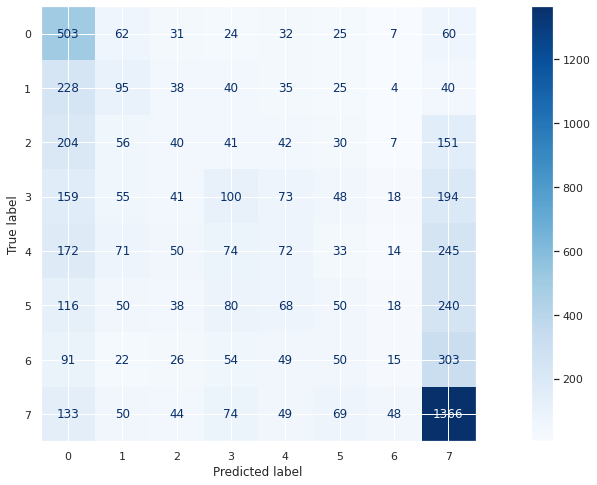

In [ ]:
#Hyperparameter Tuning the KNN Model
#Create the parameter grid
param_grid = {'n_neighbors' : [5,10,15,20]}

knn = KNeighborsClassifier()

# search of parameters, using 3 fold cross validation,
# search across 4 different combinations
knn_random = GridSearchCV(knn, param_grid, cv = 3, scoring = 'recall_weighted', refit = True, verbose = 3)

# Fit the random search model
knn_random.fit(X_train, Y_train)

#print best parameters
print('The best parameters: ', knn_random.best_params_)

#accuracy for best estimator
bestknn = knn_random.best_estimator_
best_knn_acc = bestknn.score(X_train,Y_train)
print('Accuracy of the KNN model with hyperparameter tuning:  %.4f' % (best_knn_acc*100))

#Precision, Recall & F1-Score
Y_knnhp = bestknn.predict(X_test)
print('Precision: %.4f' % precision_score(Y_test, Y_knnhp, average='weighted'))
print('Recall: %.4f' % recall_score(Y_test, Y_knnhp, average='weighted'))
print('F1 Score: %.4f' % f1_score(Y_test, Y_knnhp, average='weighted'))

#confusion_matrix for the testing
disp = plot_confusion_matrix(bestknn, X_test, Y_test ,display_labels=None, cmap=plt.cm.Blues)

print(metrics.classification_report(Y_test, Y_knnhp, digits=8))

LOGISTIC REGRESSION

Accuracy for the Logistic Regression model on the training data 55.3114


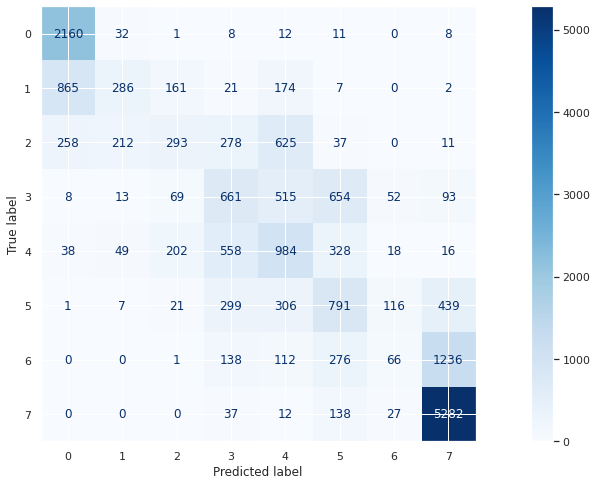

In [ ]:
#Fitting the Regression moel - Baseline

logistic = LogisticRegression(solver='liblinear', max_iter = 1000).fit(X_train, Y_train)

logistic_train_acc = logistic.score(X_train,Y_train)
print('Accuracy for the Logistic Regression model on the training data %.4f' % (logistic_train_acc*100))

#confusion_matrix for the training
disp = plot_confusion_matrix(logistic, X_train, Y_train ,display_labels=None, cmap=plt.cm.Blues)

#coefficients
#pd.DataFrame(zip(X_train.columns, np.transpose(logistic.coef_.tolist()[0])), columns=['features', 'coef'])

Accuracy for the Logistic Regression model on the test data 54.9669
Precision: 0.5018
Recall: 0.5497
F1 Score: 0.5009


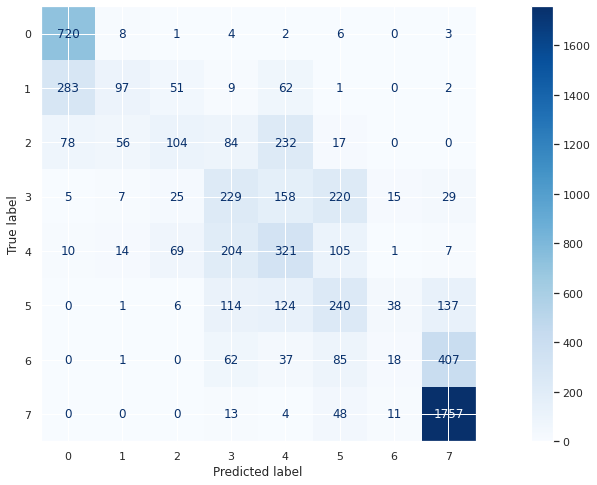

In [ ]:
# Testing the logistic Regression Model - Baseline

#the accuracy on the test data
logistic_test_acc = logistic.score(X_test,Y_test)
print('Accuracy for the Logistic Regression model on the test data %.4f' % (logistic_test_acc*100))

#Precision, Recall & F1-Score
Y_logi = logistic.predict(X_test)
print('Precision: %.4f' % precision_score(Y_test, Y_logi, average='weighted'))
print('Recall: %.4f' % recall_score(Y_test, Y_logi, average='weighted'))
print('F1 Score: %.4f' % f1_score(Y_test, Y_logi, average='weighted'))

#confusion_matrix for the testing
disp = plot_confusion_matrix(logistic, X_test, Y_test ,display_labels=None, cmap=plt.cm.Blues)


Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] C=0.1, solver=newton-cg .........................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV] ............. C=0.1, solver=newton-cg, score=0.577, total=   2.8s
[CV] C=0.1, solver=newton-cg .........................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.8s remaining:    0.0s


[CV] ............. C=0.1, solver=newton-cg, score=0.569, total=   2.9s
[CV] C=0.1, solver=newton-cg .........................................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    5.7s remaining:    0.0s


[CV] ............. C=0.1, solver=newton-cg, score=0.569, total=   2.6s
[CV] C=0.1, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=0.1, solver=lbfgs, score=nan, total=   4.7s
[CV] C=0.1, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=0.1, solver=lbfgs, score=nan, total=   4.8s
[CV] C=0.1, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=0.1, solver=lbfgs, score=nan, total=   4.9s
[CV] C=0.2, solver=newton-cg .........................................
[CV] ............. C=0.2, solver=newton-cg, score=0.603, total=   3.2s
[CV] C=0.2, solver=newton-cg .........................................
[CV] ............. C=0.2, solver=newton-cg, score=0.598, total=   3.2s
[CV] C=0.2, solver=newton-cg .........................................
[CV] ............. C=0.2, solver=newton-cg, score=0.592, total=   3.1s
[CV] C=0.2, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=0.2, solver=lbfgs, score=nan, total=   4.8s
[CV] C=0.2, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=0.2, solver=lbfgs, score=nan, total=   4.8s
[CV] C=0.2, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=0.2, solver=lbfgs, score=nan, total=   4.8s
[CV] C=0.4, solver=newton-cg .........................................
[CV] ............. C=0.4, solver=newton-cg, score=0.621, total=   3.7s
[CV] C=0.4, solver=newton-cg .........................................
[CV] ............. C=0.4, solver=newton-cg, score=0.616, total=   3.6s
[CV] C=0.4, solver=newton-cg .........................................
[CV] ............. C=0.4, solver=newton-cg, score=0.611, total=   3.4s
[CV] C=0.4, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=0.4, solver=lbfgs, score=nan, total=   4.7s
[CV] C=0.4, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=0.4, solver=lbfgs, score=nan, total=   4.7s
[CV] C=0.4, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=0.4, solver=lbfgs, score=nan, total=   4.8s
[CV] C=0.8, solver=newton-cg .........................................
[CV] ............. C=0.8, solver=newton-cg, score=0.633, total=   4.4s
[CV] C=0.8, solver=newton-cg .........................................
[CV] ............. C=0.8, solver=newton-cg, score=0.629, total=   4.3s
[CV] C=0.8, solver=newton-cg .........................................
[CV] ............. C=0.8, solver=newton-cg, score=0.624, total=   4.4s
[CV] C=0.8, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=0.8, solver=lbfgs, score=nan, total=   4.7s
[CV] C=0.8, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=0.8, solver=lbfgs, score=nan, total=   4.7s
[CV] C=0.8, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=0.8, solver=lbfgs, score=nan, total=   4.7s
[CV] C=1.0, solver=newton-cg .........................................
[CV] ............. C=1.0, solver=newton-cg, score=0.635, total=   5.0s
[CV] C=1.0, solver=newton-cg .........................................
[CV] ............. C=1.0, solver=newton-cg, score=0.633, total=   4.6s
[CV] C=1.0, solver=newton-cg .........................................
[CV] ............. C=1.0, solver=newton-cg, score=0.629, total=   4.4s
[CV] C=1.0, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=1.0, solver=lbfgs, score=nan, total=   4.8s
[CV] C=1.0, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=1.0, solver=lbfgs, score=nan, total=   4.8s
[CV] C=1.0, solver=lbfgs .............................................


/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:548: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1407, in fit
    fold_coefs_ = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py", line 1041, in __call__
    if self.dispatch_one_batch(iterator):
  File "/software/linux-el7-x86_64/compilers/python-ood-3.8.5/lib/python3.8/site-packages/joblib/parallel.py",

[CV] ................... C=1.0, solver=lbfgs, score=nan, total=   4.7s
The best parameters:  {'C': 1.0, 'solver': 'newton-cg'}
Accuracy of the Logistic Regression model with hyperparameter tuning:  63.9369
Precision: 0.6169
Recall: 0.6369
F1 Score: 0.6197
              precision    recall  f1-score   support

           0  0.73741794 0.90591398 0.81302774       744
           1  0.50118765 0.41782178 0.45572354       505
           2  0.47582697 0.32749562 0.38796680       571
           3  0.48175182 0.47965116 0.48069920       688
           4  0.50348837 0.59233926 0.54431175       731
           5  0.51957831 0.52272727 0.52114804       660
           6  0.48632219 0.26229508 0.34078807       610
           7  0.81840077 0.92689580 0.86927603      1833

    accuracy                      0.63686534      6342
   macro avg  0.56549675 0.55439250 0.55161765      6342
weighted avg  0.61694071 0.63686534 0.61974084      6342



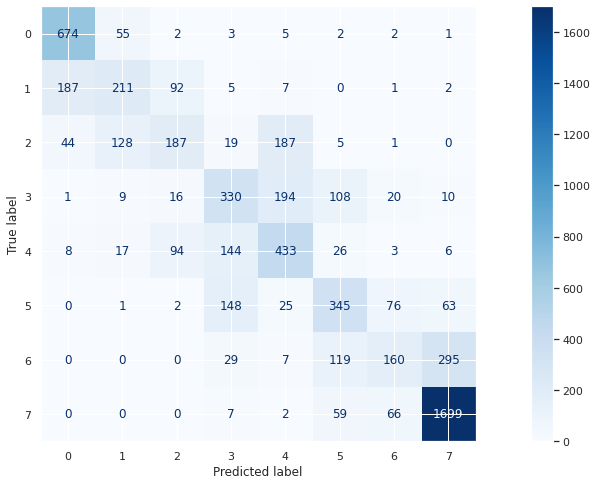

In [ ]:
#Hyperparameter Tuning the logistic regression Model
#Create the parameter grid
param_grid = {'solver':['newton-cg', 'lbfgs'],
              'C': [0.1,0.2,0.4,0.8,1.0]}

LR = LogisticRegression(multi_class='multinomial', max_iter = 1000)

# search of parameters, using 3 fold cross validation,
# search across 12 different combinations
LR_random = GridSearchCV(LR, param_grid, cv = 3, scoring = "recall_weighted", refit = True, verbose = 3)

# Fit the random search model
LR_random.fit(X_train, Y_train)

#print best parameters
print('The best parameters: ', LR_random.best_params_)

#accuracy for best estimator
bestlogistic = LR_random.best_estimator_
best_logistic_acc = bestlogistic.score(X_train,Y_train)
print('Accuracy of the Logistic Regression model with hyperparameter tuning:  %.4f' % (best_logistic_acc*100))
#Precision, Recall & F1-Score
Y_logihp = bestlogistic.predict(X_test)
print('Precision: %.4f' % precision_score(Y_test, Y_logihp, average='weighted'))
print('Recall: %.4f' % recall_score(Y_test, Y_logihp, average='weighted'))
print('F1 Score: %.4f' % f1_score(Y_test, Y_logihp, average='weighted'))

#confusion_matrix for the testing
disp = plot_confusion_matrix(bestlogistic, X_test, Y_test ,display_labels=None, cmap=plt.cm.Blues)

print(metrics.classification_report(Y_test, Y_logihp, digits=8))